# Augmentation

In [ ]:
import os
import json
import random
import numpy as np
from PIL import Image, ImageEnhance, ImageOps, ImageFilter
from tqdm import tqdm
from copy import deepcopy
import shutil

def flip_boxes_horizontally(boxes, img_width):
    return [[img_width - x_max, y_min, img_width - x_min, y_max] for x_min, y_min, x_max, y_max in boxes]

def add_noise(img):
    arr = np.array(img)
    noise = np.random.normal(0, 10, arr.shape).astype(np.uint8)
    noisy = np.clip(arr + noise, 0, 255).astype(np.uint8)
    return Image.fromarray(noisy)

def apply_random_augmentations(img, boxes, width, height):
    # Armazena bboxes no formato [x_min, y_min, x_max, y_max]
    new_boxes = boxes.copy()

    if random.random() < 0.5:
        img = ImageOps.mirror(img)
        new_boxes = flip_boxes_horizontally(new_boxes, width)

    if random.random() < 0.3:
        img = ImageEnhance.Brightness(img).enhance(random.uniform(0.6, 1.4))
    
    if random.random() < 0.3:
        img = ImageEnhance.Contrast(img).enhance(random.uniform(0.7, 1.3))

    if random.random() < 0.3:
        img = ImageEnhance.Color(img).enhance(random.uniform(0.7, 1.3))

    if random.random() < 0.3:
        img = img.filter(ImageFilter.GaussianBlur(radius=random.uniform(0.5, 1.5)))

    if random.random() < 0.3:
        img = add_noise(img)

    return img, new_boxes

In [ ]:
for step in ['train', 'test', 'valid']:
    base_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
    images_dir = os.path.join(base_dir, f"data/inputs/train_images/COCO_2025.05_group/{step}")
    annotations_path = os.path.join(base_dir, f"data/inputs/train_images/COCO_2025.05_group/{step}/_annotations.coco.json")

    aug_images_dir = os.path.join(base_dir, f"data/inputs/train_images/COCO_20250602_aug/{step}")
    os.makedirs(aug_images_dir, exist_ok=True)
    aug_annotations_path = os.path.join(aug_images_dir, '_annotations.coco.json')

    # Carrega anotações
    with open(annotations_path, 'r') as f:
        coco_data = json.load(f)

    # Novo dataset COCO (inicializa com categorias)
    aug_coco = {"images": [], "annotations": [], "categories": coco_data["categories"]}

    # Copia as imagens e anotações originais para o novo conjunto
    aug_coco["images"].extend(deepcopy(coco_data["images"]))
    aug_coco["annotations"].extend(deepcopy(coco_data["annotations"]))

    # Copia os arquivos de imagem originais
    for img in coco_data["images"]:
        src_path = os.path.join(images_dir, img["file_name"])
        dst_path = os.path.join(aug_images_dir, img["file_name"])
        if not os.path.exists(dst_path):
            shutil.copy(src_path, dst_path)

    # Indexadores para novas IDs
    image_id_offset = max(img["id"] for img in coco_data["images"]) + 1
    annotation_id_offset = max(ann["id"] for ann in coco_data["annotations"]) + 1

    # Agrupa anotações por imagem
    annotations_by_image = {}
    for ann in coco_data["annotations"]:
        annotations_by_image.setdefault(ann["image_id"], []).append(ann)

    # Augmenta imagens
    num_augmentations = 3
    for img in tqdm(coco_data["images"], desc=f"Aplicando augmentações para {step}"):
        for i in range(num_augmentations):
            image_path = os.path.join(images_dir, img["file_name"])
            image = Image.open(image_path).convert("RGB")
            width, height = img["width"], img["height"]

            anns = annotations_by_image.get(img["id"], [])
            boxes = []
            new_anns = []

            for ann in anns:
                x, y, w, h = ann["bbox"]
                boxes.append([x, y, x + w, y + h])
                new_anns.append(ann)

            # Aplica as augmentações
            aug_image, new_boxes = apply_random_augmentations(image, boxes, width, height)

            # Salva imagem aumentada
            new_file_name = f"aug_{i}_{img['file_name']}"
            new_image_path = os.path.join(aug_images_dir, new_file_name)
            aug_image.save(new_image_path)

            # Atualiza COCO
            new_image_id = image_id_offset
            image_id_offset += 1

            aug_coco["images"].append({
                "id": new_image_id,
                "file_name": new_file_name,
                "width": width,
                "height": height
            })

            for j, ann in enumerate(new_anns):
                x_min, y_min, x_max, y_max = new_boxes[j]
                new_ann = deepcopy(ann)
                new_ann["id"] = annotation_id_offset
                new_ann["image_id"] = new_image_id
                new_ann["bbox"] = [x_min, y_min, x_max - x_min, y_max - y_min]
                annotation_id_offset += 1
                aug_coco["annotations"].append(new_ann)

    # Salva novo JSON
    with open(aug_annotations_path, 'w') as f:
        json.dump(aug_coco, f, indent=2)

    print(f"✅ Passo: {step}")
    print(f"📁 Imagens salvas em: {aug_images_dir}")
    print(f"📝 Anotações salvas em: {aug_annotations_path}")

# Teste

Exibindo imagem: frame_0090_jpg.rf.5659aeb23b16f9249bb73924c0b6e23b_g3.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=538.3690987124463, y=110.93333333333334, width=60.64618025751073, height=332.34204444444447
Coordenadas da bounding box: x=519.1416309012875, y=105.24444444444445, width=61.51141630901287, height=349.40871111111113
Coordenadas da bounding box: x=497.16738197424894, y=110.93333333333334, width=61.080171673819734, height=340.87537777777777
Coordenadas da bounding box: x=475.1931330472103, y=110.93333333333334, width=61.36583690987125, height=346.5642666666667
Coordenadas da bounding box: x=453.21888412017165, y=116.62222222222222, width=63.681373390557944, height=338.17884444444445
Coordenadas da bounding box: x=433.9914163090129, y=110.93333333333334, width=64.2581974248927, height=349.55662222222225
Coordenadas da bounding box: x=433.9914163090129, y=122.31111111111112, width=19.48291845493562, height=325.7059555555556
Coord

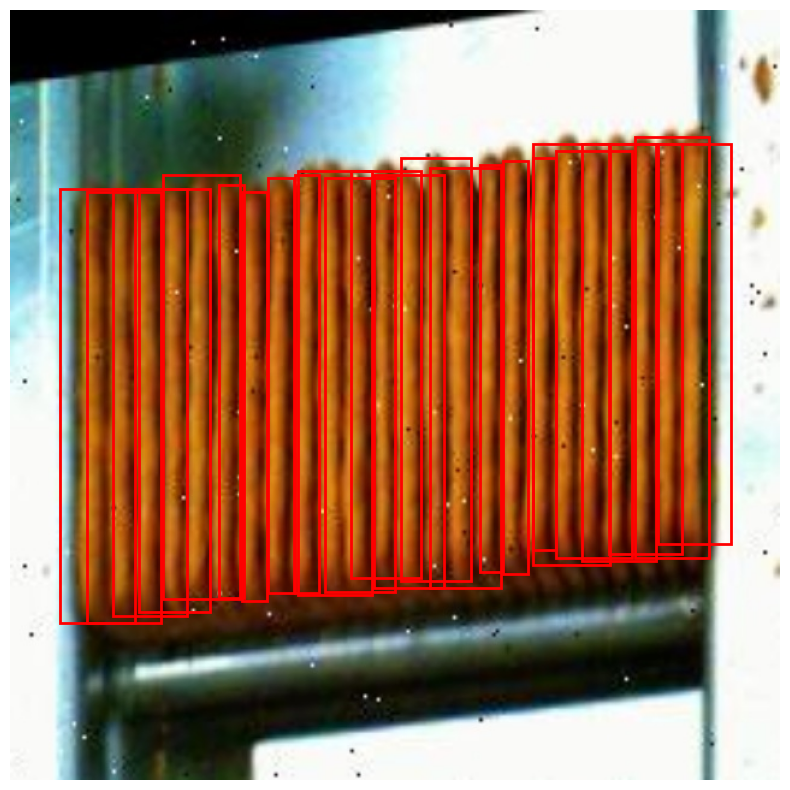

Exibindo imagem: frame_0090_jpg.rf.5659aeb23b16f9249bb73924c0b6e23b_g4.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=43.63636363636364, y=67.36842105263158, width=65.45163636363637, height=420.5103157894737
Coordenadas da bounding box: x=66.9090909090909, y=70.73684210526315, width=62.23709090909091, height=413.59494736842106
Coordenadas da bounding box: x=87.27272727272728, y=70.73684210526315, width=62.23709090909091, height=413.59494736842106
Coordenadas da bounding box: x=130.9090909090909, y=70.73684210526315, width=22.917818181818184, height=394.0075789473684
Coordenadas da bounding box: x=154.1818181818182, y=70.73684210526315, width=19.892363636363637, height=397.01894736842104
Coordenadas da bounding box: x=174.54545454545456, y=53.89473684210526, width=22.539636363636365, height=401.8694736842105
Coordenadas da bounding box: x=194.9090909090909, y=64.0, width=26.43490909090909, height=392.2324210526316
Coordenadas da bounding box

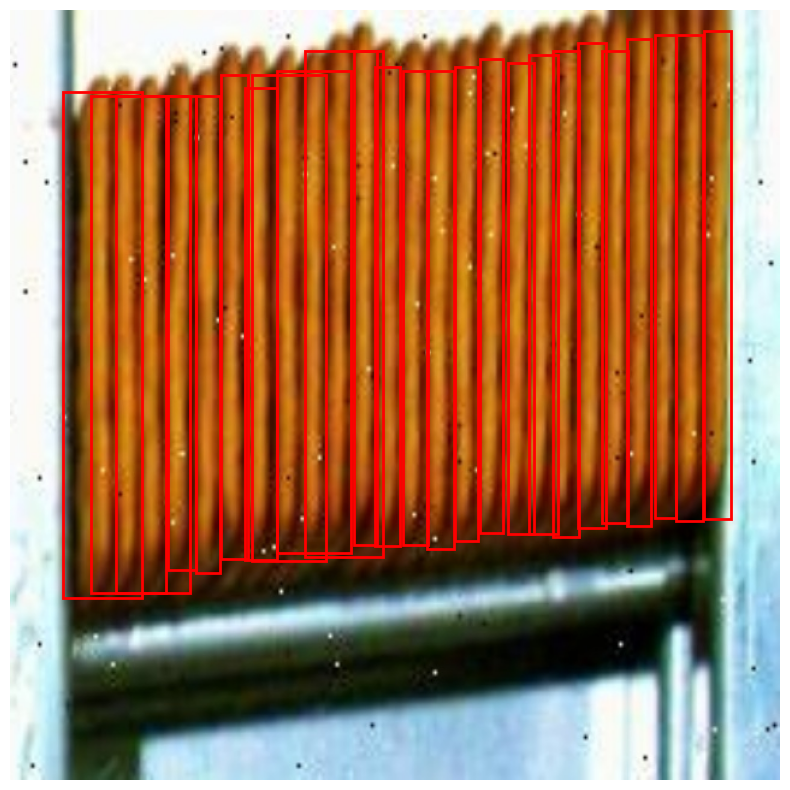

Exibindo imagem: frame_0050_jpg.rf.808874ce9c321c60f823c0d17574a868_g1.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=43.24324324324324, y=29.09090909090909, width=32.18162162162162, height=389.0763636363636
Coordenadas da bounding box: x=66.3063063063063, y=29.09090909090909, width=30.34234234234234, height=378.11636363636364
Coordenadas da bounding box: x=92.25225225225225, y=25.454545454545453, width=26.903063063063065, height=379.93090909090904
Coordenadas da bounding box: x=109.54954954954954, y=25.454545454545453, width=28.621261261261264, height=378.6181818181818
Coordenadas da bounding box: x=129.7297297297297, y=21.818181818181817, width=27.71315315315315, height=378.32363636363635
Coordenadas da bounding box: x=155.67567567567568, y=21.818181818181817, width=30.3827027027027, height=382.9672727272727
Coordenadas da bounding box: x=172.97297297297297, y=18.18181818181818, width=32.957117117117114, height=378.9672727272727
Coordenad

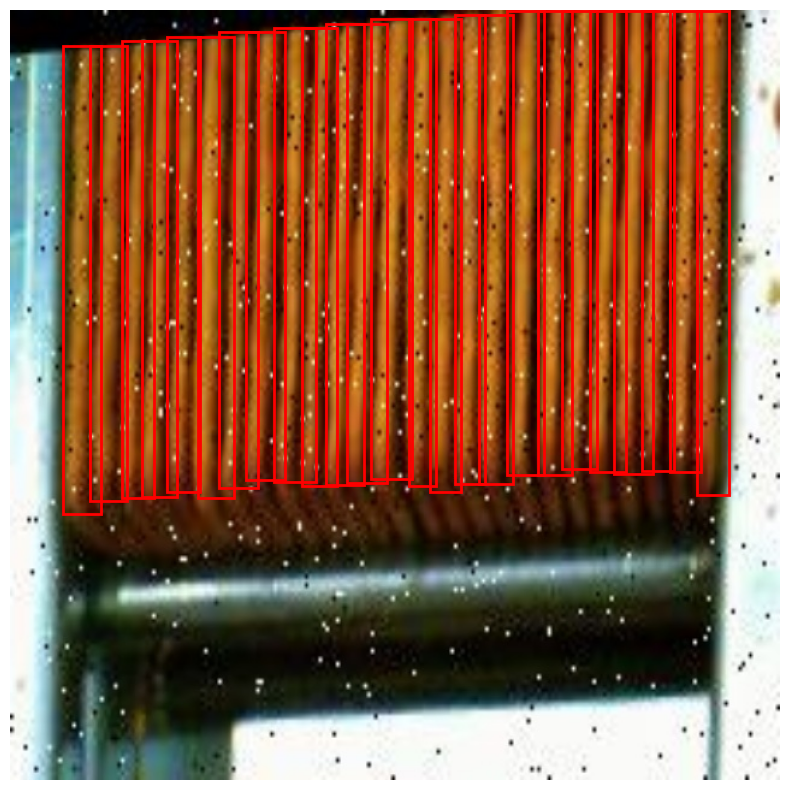

Exibindo imagem: frame_0050_jpg.rf.808874ce9c321c60f823c0d17574a868_g2.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=44.23963133640553, y=0.0, width=31.28331797235023, height=378.55041916167664
Coordenadas da bounding box: x=70.78341013824885, y=0.0, width=27.13069124423963, height=369.425628742515
Coordenadas da bounding box: x=88.47926267281106, y=0.0, width=31.188940092165897, height=372.82874251497003
Coordenadas da bounding box: x=109.12442396313365, y=0.0, width=32.27428571428572, height=367.9118562874251
Coordenadas da bounding box: x=132.7188940092166, y=0.0, width=29.64940092165899, height=364.13700598802393
Coordenadas da bounding box: x=156.31336405529956, y=0.0, width=31.168294930875575, height=388.28838323353295
Coordenadas da bounding box: x=182.85714285714286, y=0.0, width=28.009585253456223, height=377.69580838323355
Coordenadas da bounding box: x=203.50230414746545, y=0.0, width=30.416221198156684, height=374.1777245508982

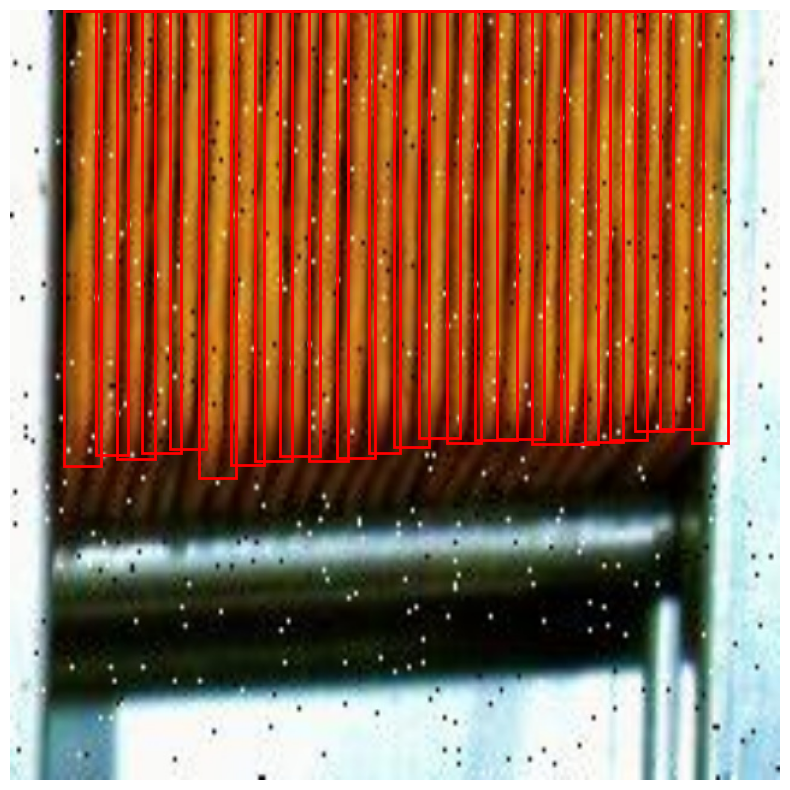

Exibindo imagem: frame_0050_jpg.rf.808874ce9c321c60f823c0d17574a868_g3.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=43.049327354260086, y=203.76681614349775, width=35.31479820627803, height=358.5090582959641
Coordenadas da bounding box: x=66.00896860986546, y=206.63677130044843, width=33.63587443946189, height=355.1339910313901
Coordenadas da bounding box: x=88.96860986547085, y=77.48878923766816, width=27.026367713004483, height=353.56412556053806
Coordenadas da bounding box: x=111.92825112107623, y=206.63677130044843, width=23.771838565022417, height=353.1967713004484
Coordenadas da bounding box: x=137.7578475336323, y=86.09865470852017, width=24.566816143497757, height=350.197668161435
Coordenadas da bounding box: x=160.71748878923765, y=206.63677130044843, width=22.10726457399103, height=350.03982062780267
Coordenadas da bounding box: x=180.80717488789236, y=206.63677130044843, width=23.737399103139015, height=352.6629596412556
Coorde

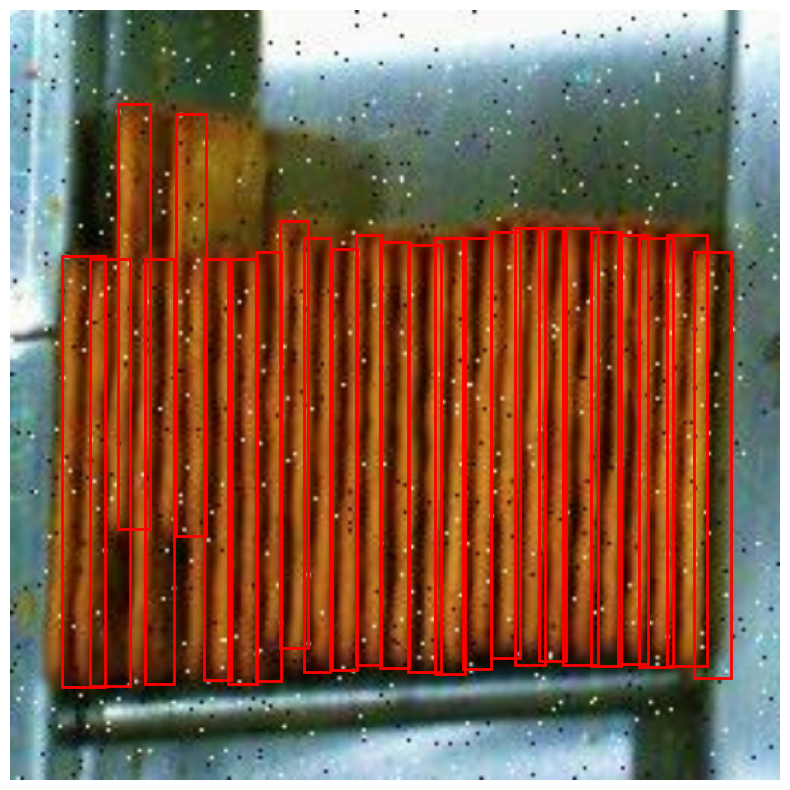

Exibindo imagem: frame_0050_jpg.rf.808874ce9c321c60f823c0d17574a868_g4.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=44.23963133640553, y=162.21198156682027, width=34.10580645161291, height=367.80534562211983
Coordenadas da bounding box: x=73.73271889400922, y=159.2626728110599, width=25.585253456221203, height=368.6134562211982
Coordenadas da bounding box: x=97.32718894009217, y=171.05990783410138, width=28.039078341013823, height=358.22599078341017
Coordenadas da bounding box: x=120.92165898617512, y=159.2626728110599, width=27.213271889400925, height=358.95741935483875
Coordenadas da bounding box: x=138.61751152073734, y=150.41474654377882, width=29.879447004608295, height=368.19760368663594
Coordenadas da bounding box: x=159.2626728110599, y=147.46543778801845, width=30.73179723502304, height=369.21216589861757
Coordenadas da bounding box: x=182.85714285714286, y=159.2626728110599, width=28.94451612903226, height=362.18396313364053
Coo

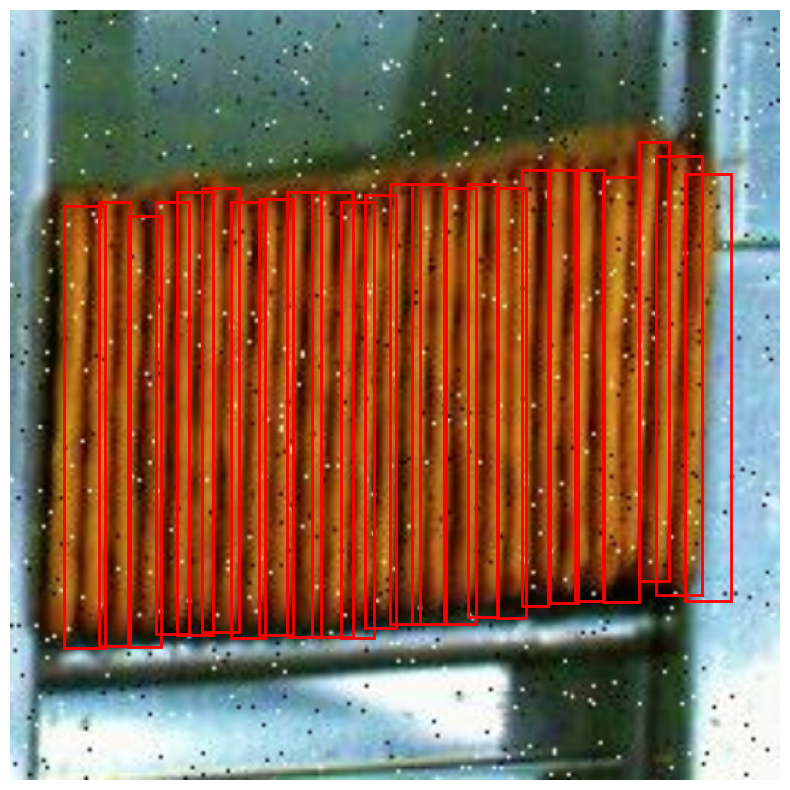

Exibindo imagem: frame_0231_jpg.rf.7353f2637a2009777ac6539b872180e5_g1.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=42.290748898678416, y=218.05309734513273, width=62.759471365638774, height=347.85982300884956
Coordenadas da bounding box: x=56.38766519823789, y=130.26548672566372, width=59.54819383259912, height=336.4021238938053
Coordenadas da bounding box: x=78.94273127753304, y=130.26548672566372, width=56.53145374449339, height=330.6053097345133
Coordenadas da bounding box: x=101.4977973568282, y=116.10619469026548, width=57.51541850220264, height=358.9238938053097
Coordenadas da bounding box: x=115.59471365638767, y=118.93805309734513, width=62.56211453744494, height=342.19610619469023
Coordenadas da bounding box: x=140.96916299559473, y=118.93805309734513, width=62.46625550660793, height=339.3642477876106
Coordenadas da bounding box: x=160.70484581497797, y=107.61061946902655, width=63.055506607929516, height=356.3553982300885
Coord

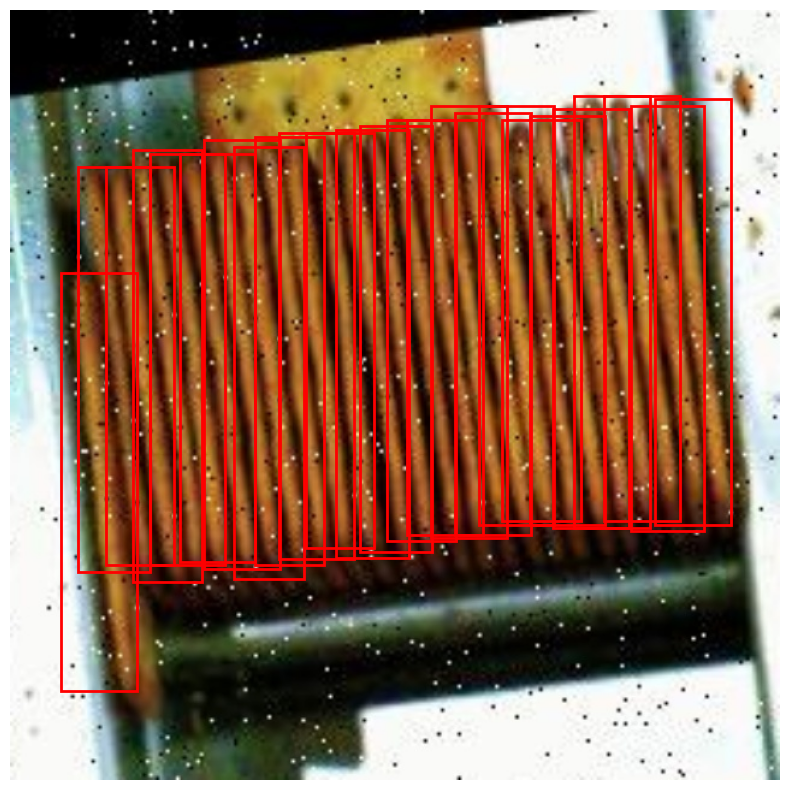

Exibindo imagem: frame_0231_jpg.rf.7353f2637a2009777ac6539b872180e5_g2.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=41.02564102564103, y=180.51282051282053, width=60.882051282051286, height=335.96717948717946
Coordenadas da bounding box: x=62.90598290598291, y=172.30769230769232, width=58.62564102564102, height=349.5165811965812
Coordenadas da bounding box: x=79.31623931623932, y=164.10256410256412, width=61.64786324786325, height=357.8475213675214
Coordenadas da bounding box: x=101.19658119658119, y=158.63247863247864, width=59.008547008547005, height=360.45675213675213
Coordenadas da bounding box: x=125.81196581196582, y=158.63247863247864, width=64.66735042735043, height=366.18119658119656
Coordenadas da bounding box: x=144.95726495726495, y=155.8974358974359, width=64.19145299145299, height=352.5059829059829
Coordenadas da bounding box: x=169.57264957264957, y=155.8974358974359, width=61.360683760683756, height=349.64239316239315
Coor

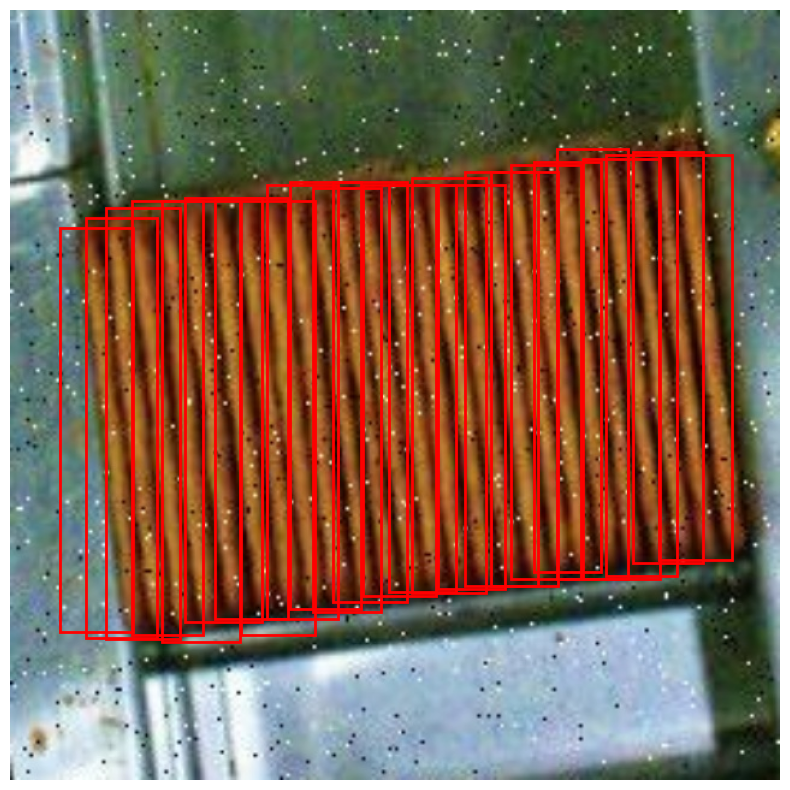

Exibindo imagem: frame_0231_jpg.rf.7353f2637a2009777ac6539b872180e5_g3.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=42.85714285714286, y=30.802139037433154, width=55.42857142857142, height=433.6222459893048
Coordenadas da bounding box: x=60.0, y=37.64705882352941, width=63.50000000000001, height=416.9856684491978
Coordenadas da bounding box: x=85.71428571428572, y=34.224598930481285, width=57.58857142857143, height=409.8224598930481
Coordenadas da bounding box: x=102.85714285714286, y=27.379679144385026, width=58.08571428571428, height=426.9347593582888
Coordenadas da bounding box: x=120.0, y=17.112299465240643, width=60.642857142857146, height=416.82823529411763
Coordenadas da bounding box: x=142.85714285714286, y=13.689839572192513, width=60.84285714285715, height=423.6731550802139
Coordenadas da bounding box: x=162.85714285714286, y=23.9572192513369, width=57.58857142857143, height=409.8224598930481
Coordenadas da bounding box: x=182.8

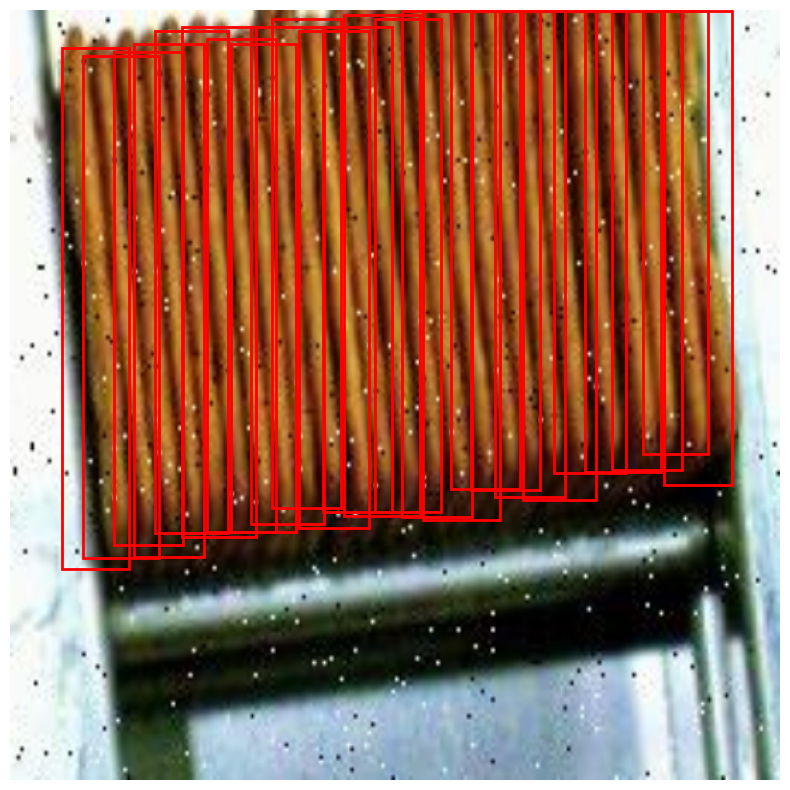

Exibindo imagem: frame_0231_jpg.rf.7353f2637a2009777ac6539b872180e5_g4.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=530.9417040358744, y=100.44843049327353, width=67.15695067264573, height=364.1542600896861
Coordenadas da bounding box: x=513.7219730941704, y=120.53811659192824, width=58.2457399103139, height=355.142600896861
Coordenadas da bounding box: x=493.63228699551564, y=120.53811659192824, width=58.34618834080717, height=358.01255605381164
Coordenadas da bounding box: x=479.2825112107623, y=152.10762331838563, width=60.71677130044842, height=343.79766816143496
Coordenadas da bounding box: x=447.7130044843049, y=129.14798206278027, width=61.61793721973093, height=369.627264573991
Coordenadas da bounding box: x=430.4932735426009, y=134.8878923766816, width=52.80717488789237, height=363.4855605381166
Coordenadas da bounding box: x=370.22421524663673, y=132.01793721973092, width=61.316591928251114, height=361.017399103139
Coordenadas d

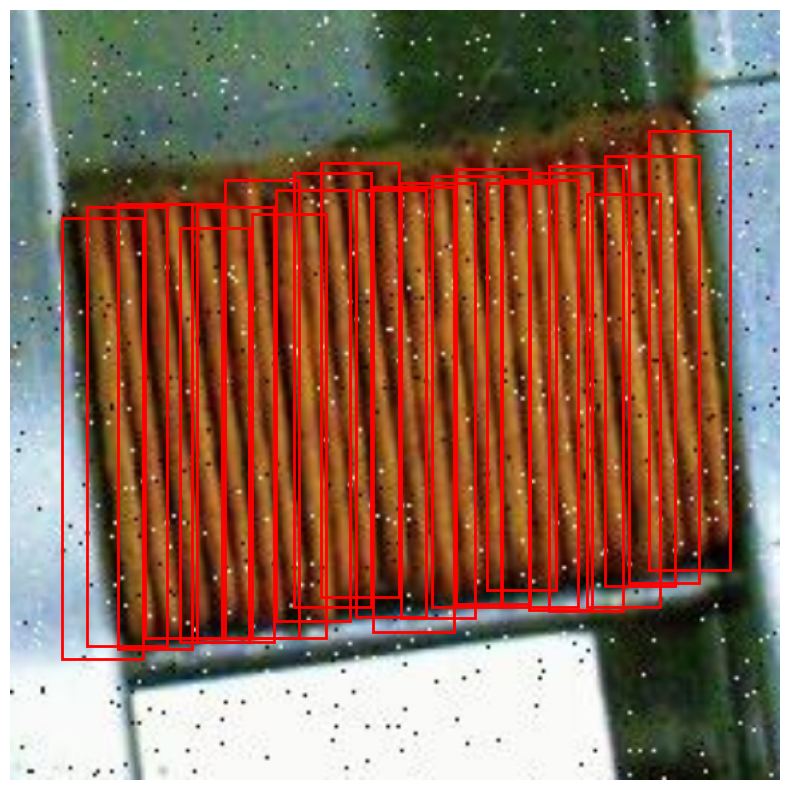

Exibindo imagem: frame_0060_jpg.rf.100f464ec9cfc3274eded8d5d6df7626_g1.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=562.5112107623318, y=149.23766816143498, width=35.71085201793721, height=356.6091479820628
Coordenadas da bounding box: x=393.1838565022421, y=146.3677130044843, width=38.51479820627802, height=350.9352466367713
Coordenadas da bounding box: x=416.1434977578475, y=143.49775784753362, width=32.80645739910314, height=353.67318385650225
Coordenadas da bounding box: x=439.1031390134529, y=146.3677130044843, width=29.90493273542601, height=350.7343497757847
Coordenadas da bounding box: x=459.1928251121076, y=149.23766816143498, width=29.93650224215246, height=353.60430493273543
Coordenadas da bounding box: x=482.152466367713, y=143.49775784753362, width=29.93650224215246, height=353.60430493273543
Coordenadas da bounding box: x=499.372197309417, y=152.10762331838563, width=35.676412556053805, height=353.73919282511207
Coordenadas 

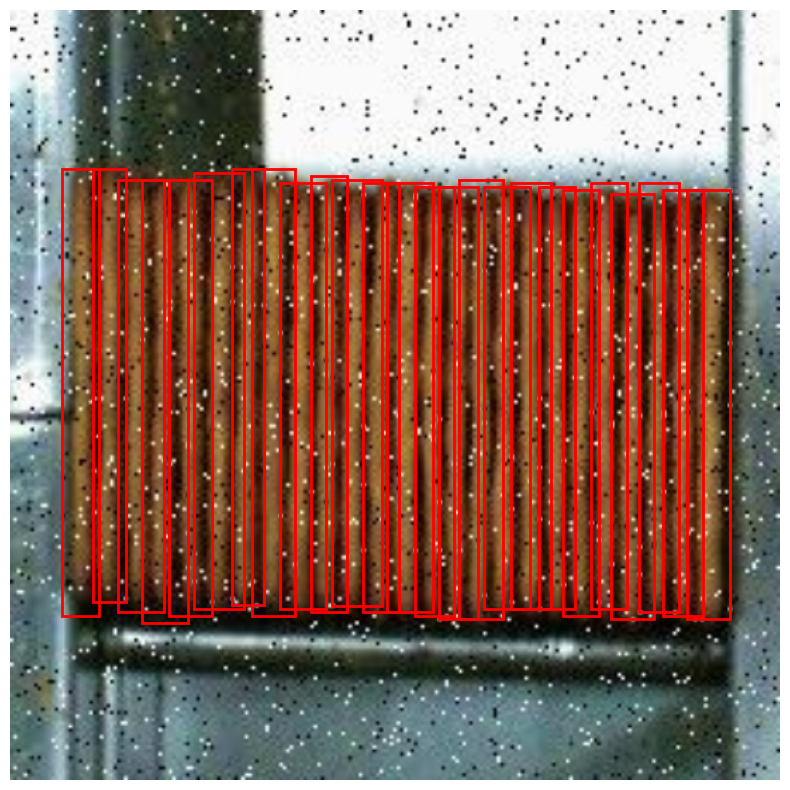

Exibindo imagem: frame_0060_jpg.rf.100f464ec9cfc3274eded8d5d6df7626_g2.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=44.44444444444444, y=148.14814814814815, width=33.80148148148148, height=359.2088888888889
Coordenadas da bounding box: x=68.14814814814814, y=133.33333333333331, width=33.97333333333333, height=374.0237037037037
Coordenadas da bounding box: x=94.81481481481481, y=130.37037037037035, width=30.977777777777778, height=370.98962962962963
Coordenadas da bounding box: x=109.62962962962962, y=130.37037037037035, width=33.86962962962963, height=365.13481481481483
Coordenadas da bounding box: x=136.29629629629628, y=133.33333333333331, width=33.837037037037035, height=362.17185185185184
Coordenadas da bounding box: x=154.07407407407408, y=124.44444444444444, width=33.97333333333333, height=374.0237037037037
Coordenadas da bounding box: x=177.77777777777777, y=124.44444444444444, width=33.940740740740736, height=371.06074074074075
Co

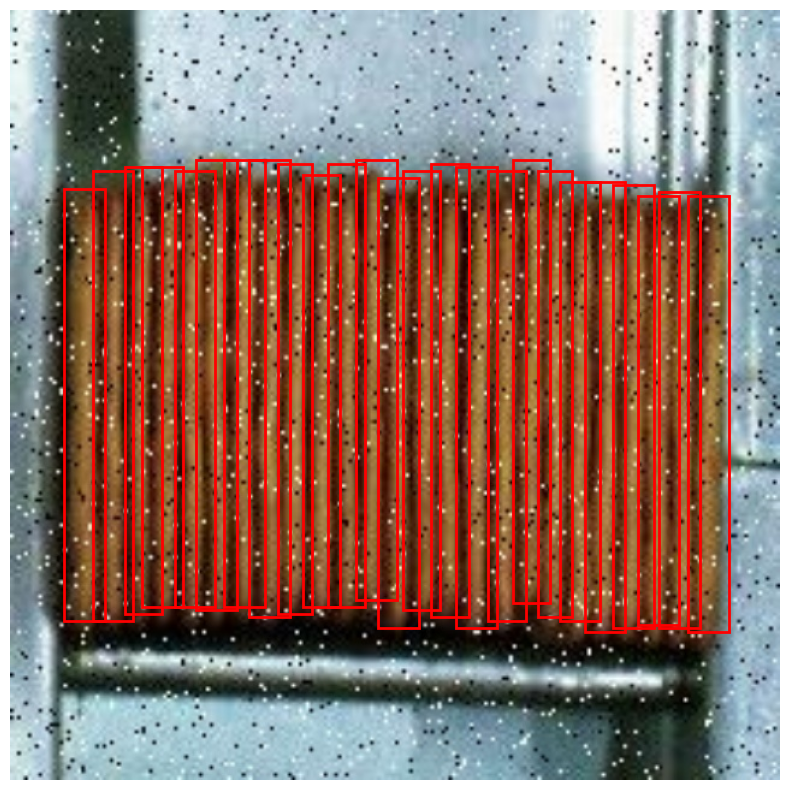

Exibindo imagem: frame_0215_jpg.rf.e2746420951c1cf969417bc56cff433a_g1.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=558.2378854625551, y=112.77533039647578, width=40.85004405286344, height=362.8010572687225
Coordenadas da bounding box: x=532.863436123348, y=109.95594713656388, width=43.6384140969163, height=360.1311013215859
Coordenadas da bounding box: x=515.9471365638767, y=121.23348017621146, width=40.78519823788546, height=357.16229074889867
Coordenadas da bounding box: x=493.39207048458155, y=121.23348017621146, width=43.539735682819384, height=351.67295154185024
Coordenadas da bounding box: x=468.01762114537445, y=126.87224669603525, width=43.50590308370044, height=348.85356828193835
Coordenadas da bounding box: x=445.46255506607935, y=118.41409691629957, width=40.78519823788546, height=357.16229074889867
Coordenadas da bounding box: x=422.9074889867842, y=115.59471365638767, width=46.42396475770926, height=357.45832599118944
Coorde

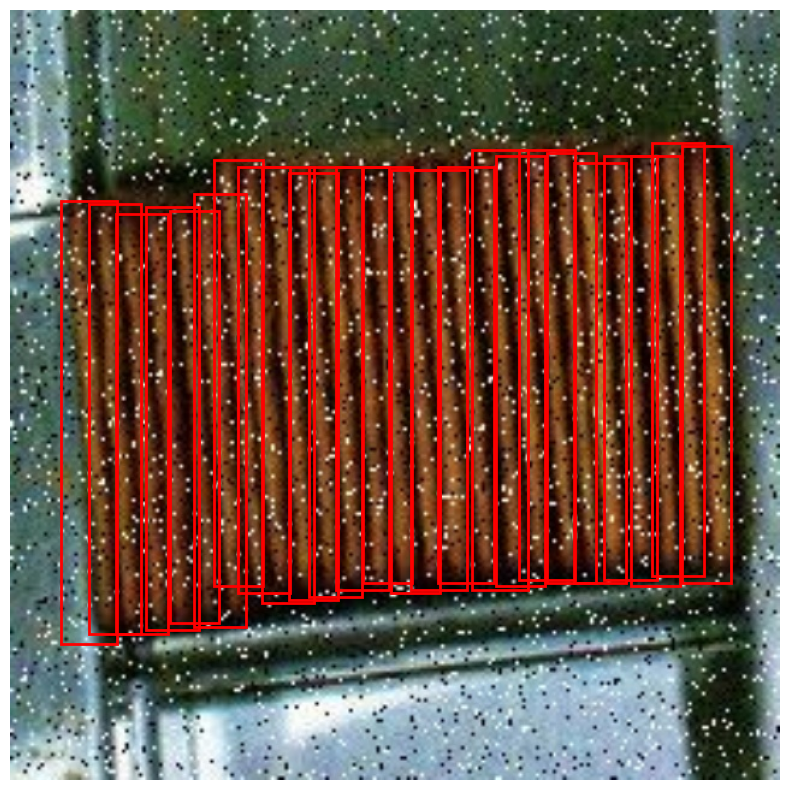

Exibindo imagem: frame_0215_jpg.rf.e2746420951c1cf969417bc56cff433a_g2.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=43.049327354260086, y=172.19730941704034, width=41.3847533632287, height=352.08896860986545
Coordenadas da bounding box: x=68.87892376681614, y=160.71748878923765, width=41.3847533632287, height=352.08896860986545
Coordenadas da bounding box: x=91.83856502242152, y=160.71748878923765, width=41.551210762331834, height=366.4387443946188
Coordenadas da bounding box: x=111.92825112107623, y=152.10762331838563, width=38.68125560538116, height=366.2895067264574
Coordenadas da bounding box: x=212.37668161434976, y=149.23766816143498, width=44.3867264573991, height=363.7208968609865
Coordenadas da bounding box: x=195.15695067264573, y=140.62780269058294, width=38.781704035874434, height=374.8993721973094
Coordenadas da bounding box: x=172.19730941704034, y=140.62780269058294, width=41.551210762331834, height=366.4387443946188
Coorde

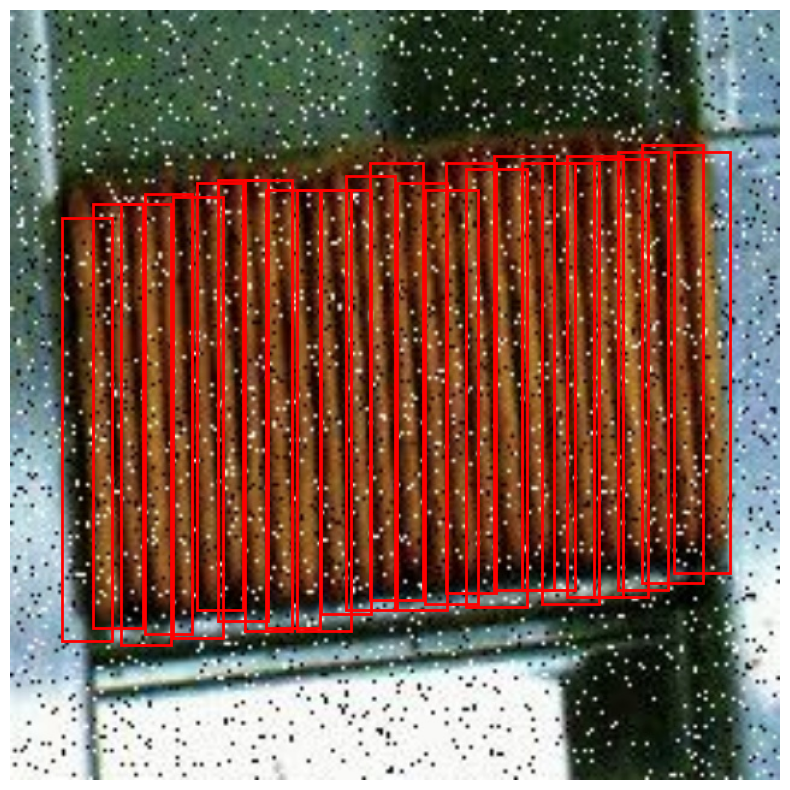

Exibindo imagem: frame_0215_jpg.rf.e2746420951c1cf969417bc56cff433a_g3.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=557.5111111111112, y=3.350785340314136, width=41.048177777777774, height=414.4284816753927
Coordenadas da bounding box: x=540.4444444444445, y=10.052356020942408, width=38.20373333333333, height=414.25424083769633
Coordenadas da bounding box: x=517.6888888888889, y=13.403141361256544, width=40.94862222222223, height=404.3761256544503
Coordenadas da bounding box: x=497.77777777777777, y=20.104712041884817, width=38.10417777777778, height=404.20188481675393
Coordenadas da bounding box: x=475.02222222222224, y=13.403141361256544, width=41.08231111111111, height=417.7792670157068
Coordenadas da bounding box: x=455.11111111111114, y=20.104712041884817, width=40.91733333333333, height=401.0253403141361
Coordenadas da bounding box: x=432.35555555555555, y=20.104712041884817, width=40.94862222222223, height=404.3761256544503
Coorden

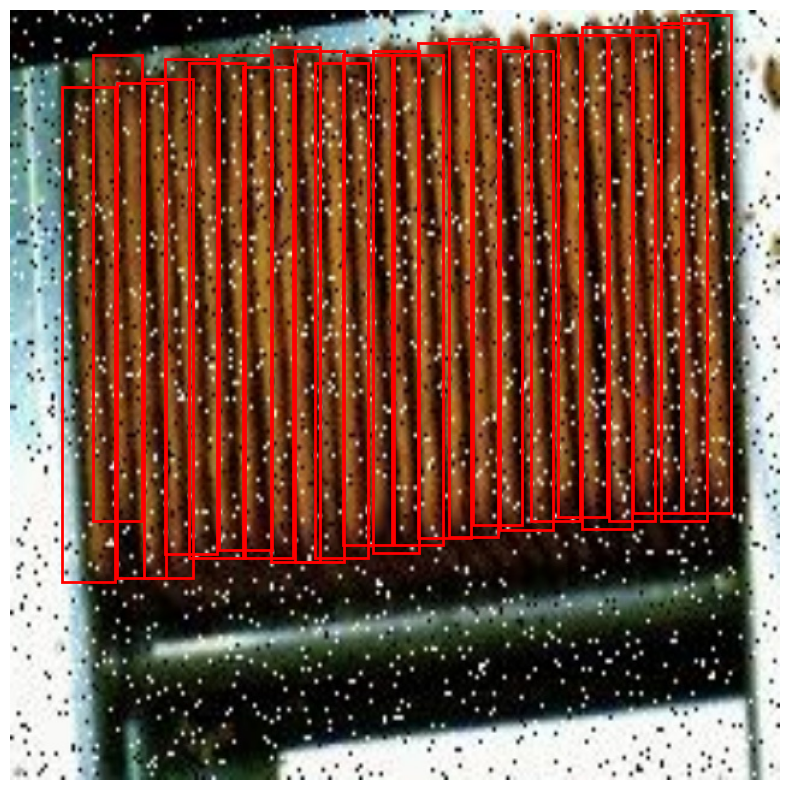

Exibindo imagem: frame_0215_jpg.rf.e2746420951c1cf969417bc56cff433a_g4.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=42.47787610619469, y=0.0, width=40.801415929203536, height=408.78644067796614
Coordenadas da bounding box: x=59.469026548672566, y=0.0, width=40.835398230088494, height=403.93762711864406
Coordenadas da bounding box: x=82.12389380530973, y=0.0, width=43.633274336283186, height=395.2849717514124
Coordenadas da bounding box: x=101.94690265486726, y=0.0, width=46.499115044247795, height=401.189604519774
Coordenadas da bounding box: x=121.76991150442478, y=0.0, width=43.469026548672566, height=378.1676836158192
Coordenadas da bounding box: x=141.5929203539823, y=0.0, width=40.900530973451325, height=393.01785310734465
Coordenadas da bounding box: x=158.58407079646017, y=0.0, width=46.499115044247795, height=393.69039548022596
Coordenadas da bounding box: x=184.07079646017698, y=0.0, width=37.90442477876106, height=377.5204519774

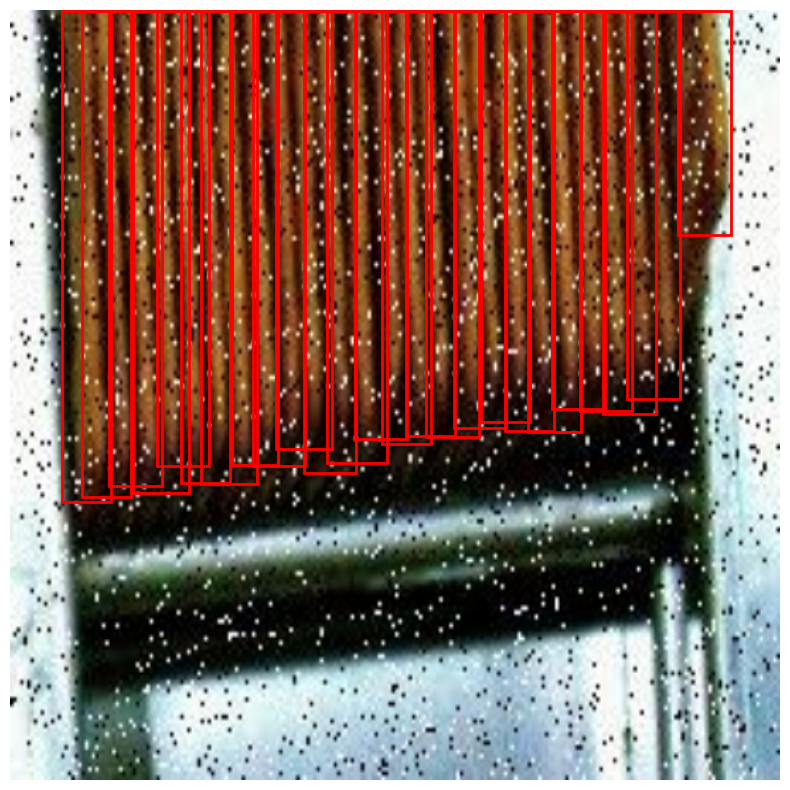

Exibindo imagem: frame_0232_jpg.rf.2d333e1e5083414bf90f83672c2eb556_g1.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=563.8095238095237, y=121.9047619047619, width=31.83238095238095, height=387.6175238095238
Coordenadas da bounding box: x=542.4761904761905, y=134.09523809523807, width=28.038095238095234, height=393.87733333333335
Coordenadas da bounding box: x=527.2380952380952, y=137.14285714285714, width=20.82133333333333, height=381.5558095238095
Coordenadas da bounding box: x=493.71428571428567, y=146.28571428571428, width=31.868952380952383, height=379.23047619047617
Coordenadas da bounding box: x=472.38095238095235, y=134.09523809523807, width=34.66361904761905, height=386.8495238095238
Coordenadas da bounding box: x=454.0952380952381, y=137.14285714285714, width=29.951999999999998, height=382.9820952380952
Coordenadas da bounding box: x=429.71428571428567, y=140.19047619047618, width=31.881142857142855, height=378.8830476190476
Coord

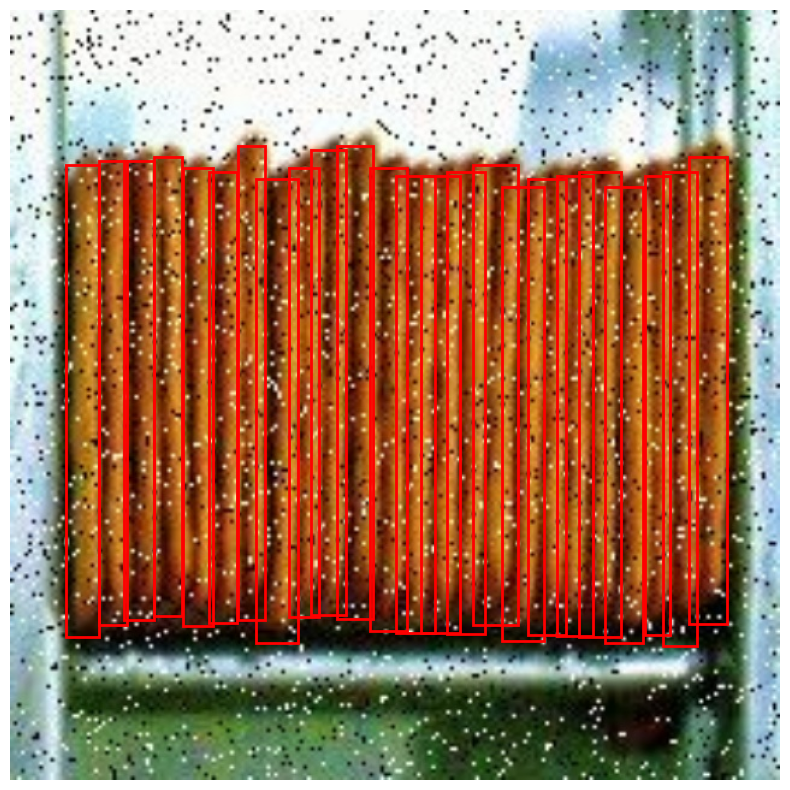

Exibindo imagem: frame_0232_jpg.rf.2d333e1e5083414bf90f83672c2eb556_g2.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=575.7077625570776, y=137.35159817351598, width=21.780456621004564, height=370.7470319634703
Coordenadas da bounding box: x=552.3287671232877, y=137.35159817351598, width=21.44730593607306, height=374.0288584474886
Coordenadas da bounding box: x=528.9497716894977, y=134.42922374429224, width=22.125296803652965, height=371.1970776255708
Coordenadas da bounding box: x=508.4931506849315, y=134.42922374429224, width=23.04, height=372.7897716894977
Coordenadas da bounding box: x=485.11415525114154, y=131.50684931506848, width=23.60109589041096, height=373.9996347031963
Coordenadas da bounding box: x=461.7351598173516, y=134.42922374429224, width=24.185570776255705, height=368.00876712328767
Coordenadas da bounding box: x=441.27853881278537, y=137.35159817351598, width=24.22063926940639, height=366.40438356164384
Coordenadas da bou

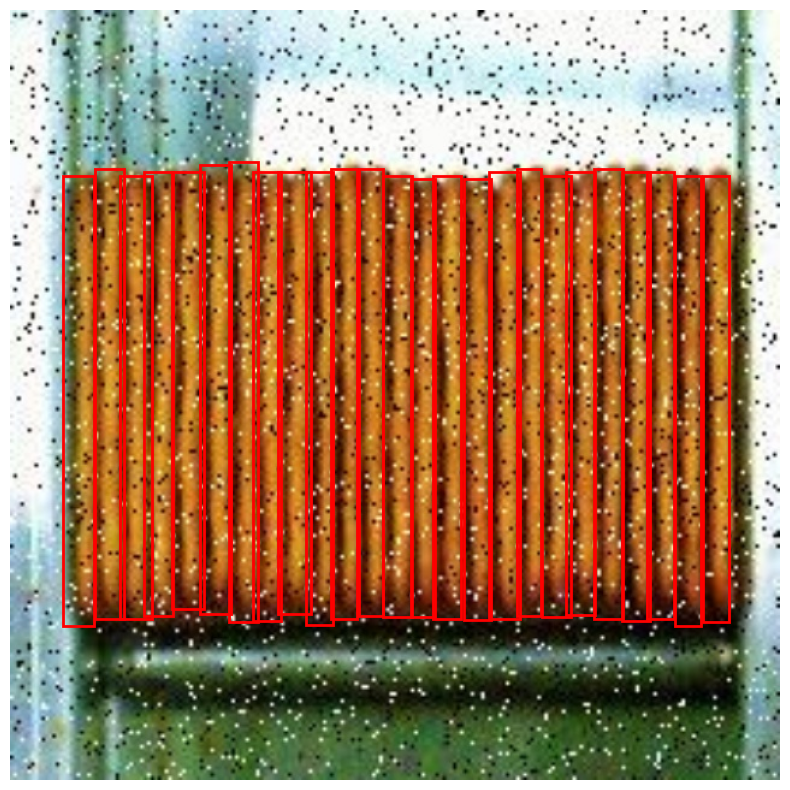

Exibindo imagem: frame_0232_jpg.rf.2d333e1e5083414bf90f83672c2eb556_g3.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=573.5849056603774, y=126.7924528301887, width=21.88981132075472, height=385.39169811320755
Coordenadas da bounding box: x=552.4528301886793, y=129.811320754717, width=21.575849056603776, height=378.828679245283
Coordenadas da bounding box: x=531.3207547169811, y=132.83018867924528, width=23.779622641509434, height=381.3162264150944
Coordenadas da bounding box: x=513.2075471698114, y=123.77358490566039, width=21.28301886792453, height=371.3932075471698
Coordenadas da bounding box: x=492.07547169811323, y=135.8490566037736, width=19.73735849056604, height=368.8120754716981
Coordenadas da bounding box: x=473.96226415094344, y=108.67924528301887, width=21.575849056603776, height=372.5464150943397
Coordenadas da bounding box: x=449.81132075471703, y=111.69811320754718, width=24.621886792452834, height=365.35547169811326
Coordenad

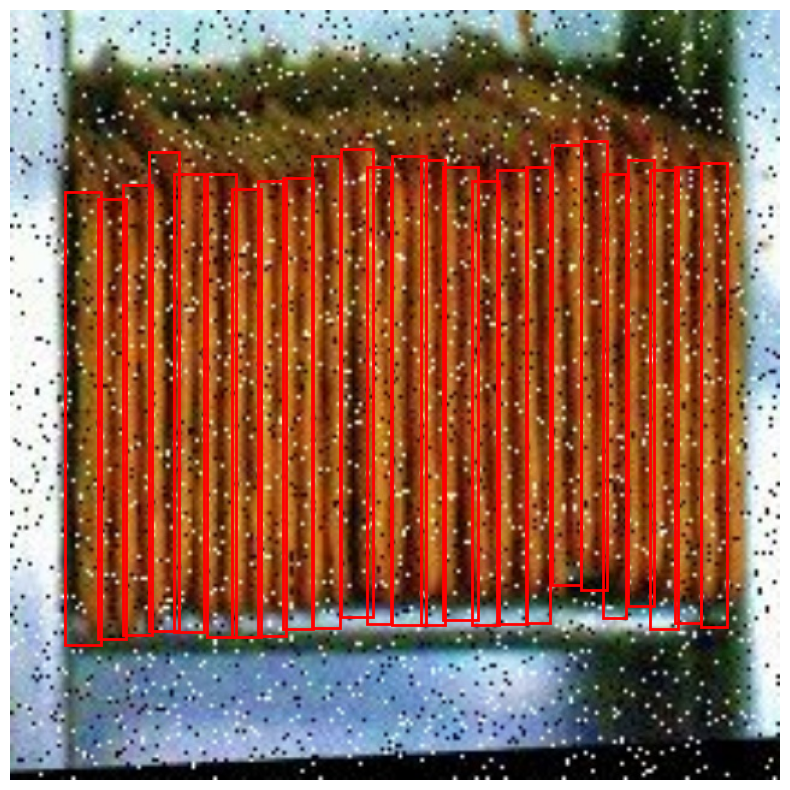

Exibindo imagem: frame_0232_jpg.rf.2d333e1e5083414bf90f83672c2eb556_g4.jpg
Dimensões da imagem: 640x640 (largura x altura, 3 canais)
Coordenadas da bounding box: x=576.0, y=145.45454545454547, width=21.998545454545457, height=365.03854545454544
Coordenadas da bounding box: x=552.7272727272727, y=136.72727272727272, width=22.289454545454547, height=361.8501818181818
Coordenadas da bounding box: x=532.3636363636364, y=136.72727272727272, width=23.136000000000003, height=371.50254545454544
Coordenadas da bounding box: x=509.0909090909091, y=130.9090909090909, width=25.847272727272728, height=372.39272727272726
Coordenadas da bounding box: x=485.8181818181818, y=130.9090909090909, width=28.52945454545455, height=377.22763636363635
Coordenadas da bounding box: x=468.3636363636364, y=125.0909090909091, width=23.136000000000003, height=379.6363636363636
Coordenadas da bounding box: x=448.0, y=130.9090909090909, width=22.612363636363636, height=373.504
Coordenadas da bounding box: x=424.727272

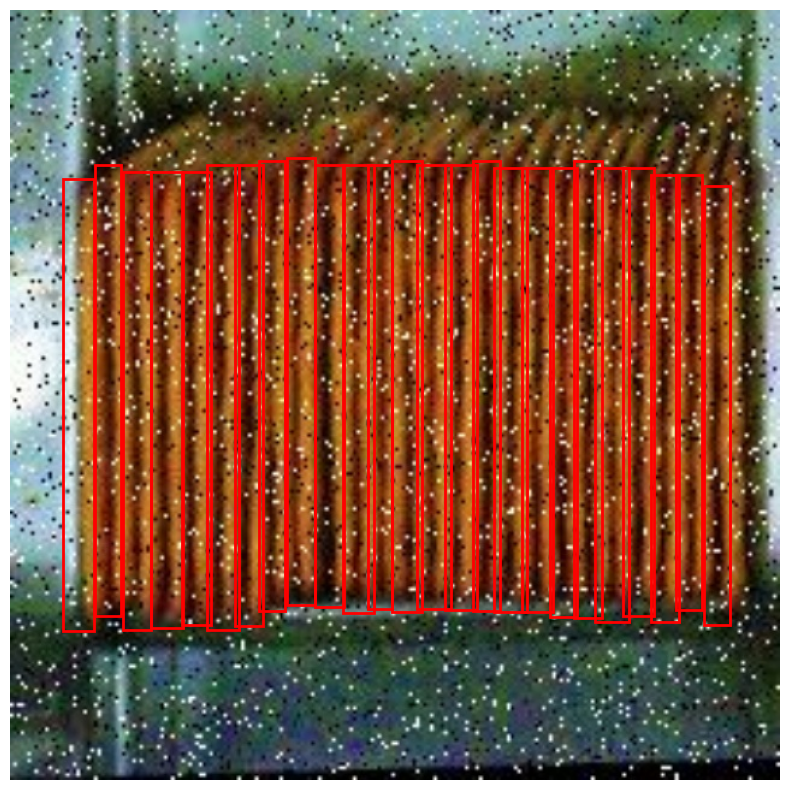

In [1]:
import os
import json
import cv2
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

base_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))

def visualize_coco_all_annotations(image_path, annotations, image_name):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width, channels = image.shape

    print(f"Exibindo imagem: {image_name}")
    print(f"Dimensões da imagem: {width}x{height} (largura x altura, {channels} canais)")

    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    for annotation in annotations:
        x, y, w, h = annotation['bbox']
        rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
        plt.gca().add_patch(rect)
        print(f"Coordenadas da bounding box: x={x}, y={y}, width={w}, height={h}")

    plt.axis('off')
    plt.show()

# Caminhos
images_dir = r'data/inputs/train_images/COCO_20250602_aug/train'
annotations_path = r'data/inputs/train_images/COCO_20250602_aug/train/_annotations.coco.json'

# Carregar JSON das anotações COCO
with open(os.path.join(base_dir, annotations_path), 'r') as f:
    coco_data = json.load(f)

# Mapear image_id para lista de anotações
annotations_dict = {}
for annotation in coco_data['annotations']:
    image_id = annotation['image_id']
    annotations_dict.setdefault(image_id, []).append(annotation)

# Para cada imagem, carregar e mostrar (com range)
start_idx = 100
end_idx = 120

for image_info in coco_data['images'][start_idx:end_idx]:
    image_file = image_info['file_name']
    image_id = image_info['id']
    image_path = os.path.join(base_dir, images_dir, image_file)

    annotations = annotations_dict.get(image_id, [])

    visualize_coco_all_annotations(image_path, annotations, image_file)

